<a href="https://colab.research.google.com/github/khatana706/DATA-SCIENCE/blob/main/OCR1_Python.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!pip install pillow

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [2]:
!pip install pytesseract

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [3]:
import pytesseract

In [4]:
import cv2
from PIL import Image

#how to open a Image

In [5]:
!pip install Pillow==9.0.0

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [50]:
my_img= Image.open('/content/linkden_pic.jpg')
print(my_img)
print(my_img.size)

<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=560x560 at 0x7FA72CCAC790>
(560, 560)


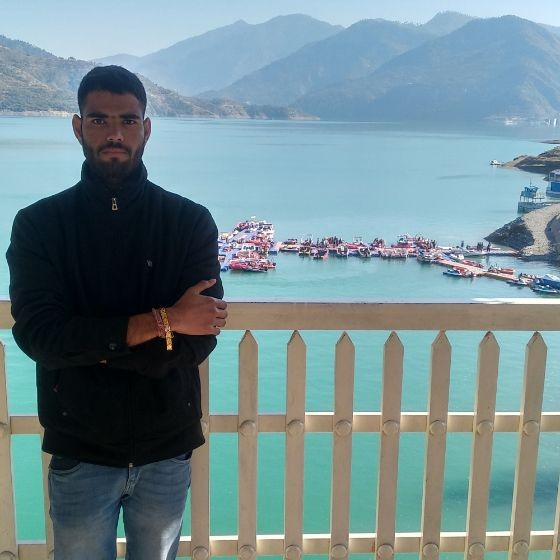

In [51]:
my_img

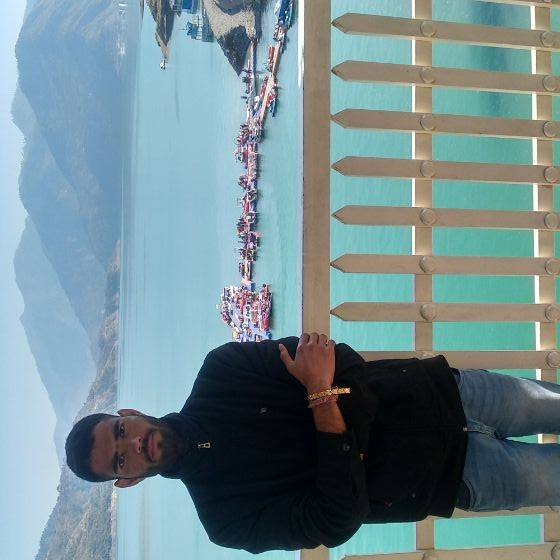

In [52]:
my_img.rotate(90)

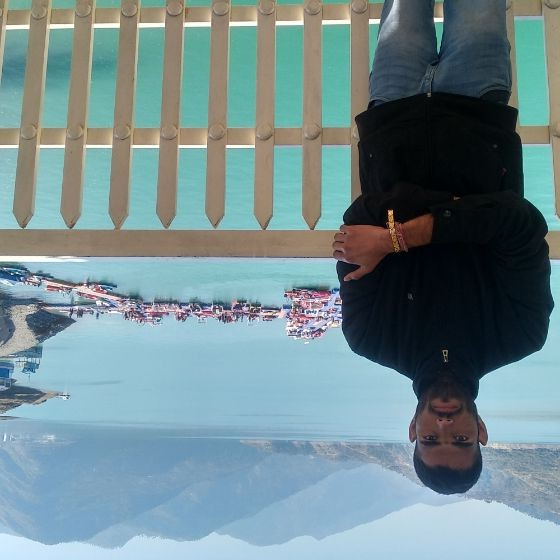

In [53]:
my_img.rotate(180)

In [54]:
my_img.save('/content/temp22linkden_pic.jpg')

#how to preprocess images for text OCR

In [55]:
#preprocessing images for OCR

In [56]:
import cv2
from matplotlib import pyplot as plt
image_file = "/content/Standard Cover Letter (2).jpg"
img = cv2.imread(image_file) 

In [57]:
my_img = Image.open("/content/Standard Cover Letter (2).jpg")
print(my_img.size)

(2481, 3509)


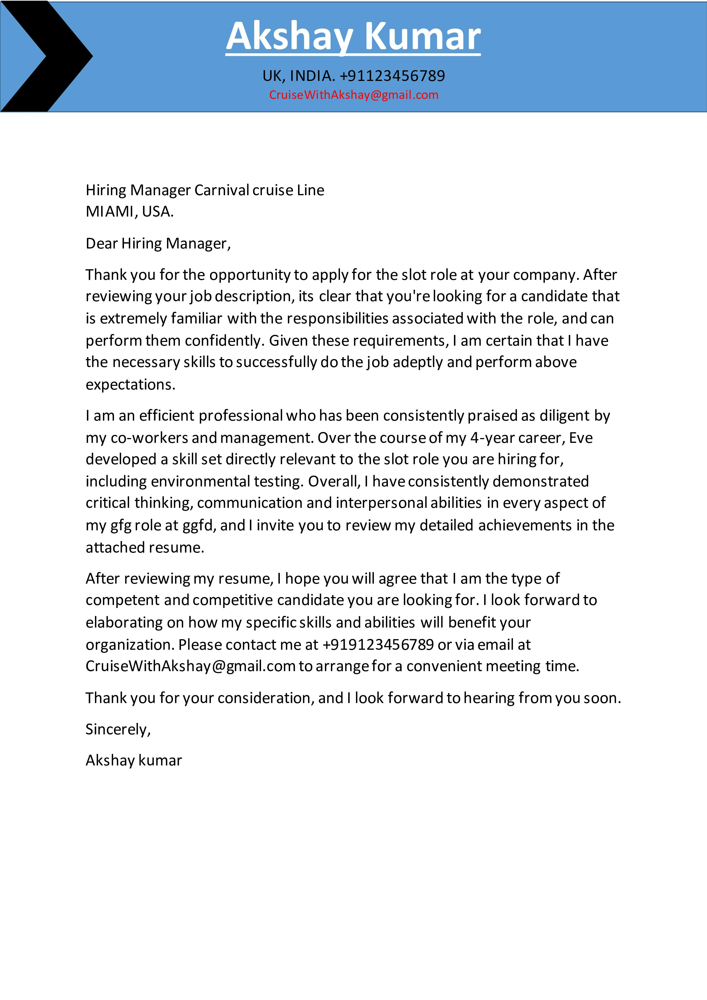

In [58]:
my_img

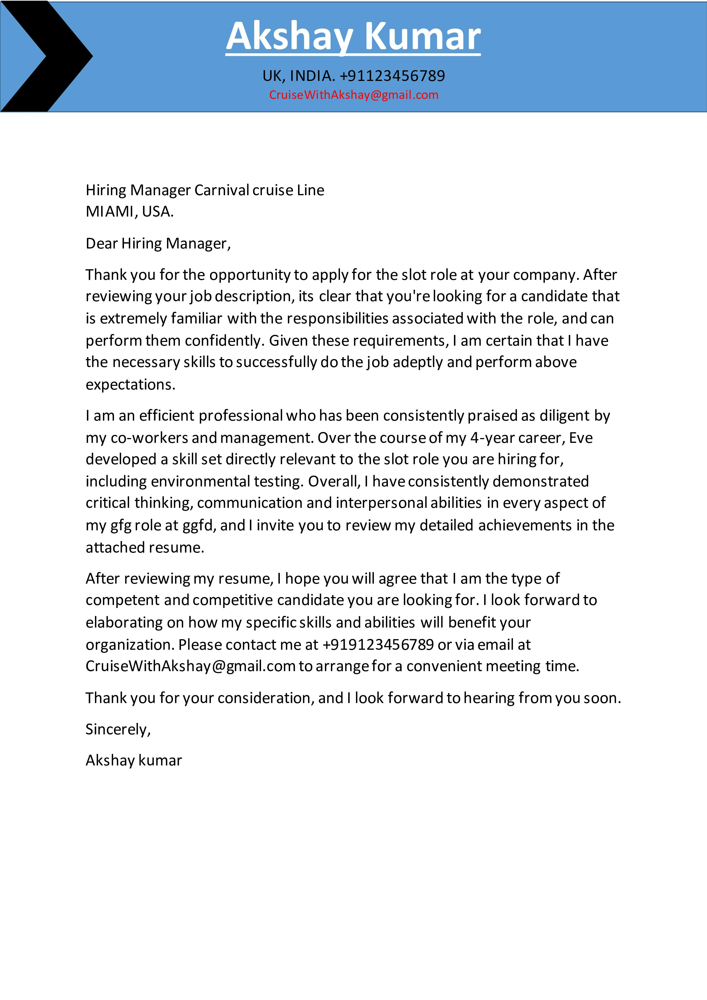

In [59]:
my_img

In [60]:
my_img.save("/content/Standard Cover Letter (2).jpg")

In [61]:
#cv2.imshow("original image", img)
#cv2.waitKey(0)

In [62]:
def display(im_path):
  dpi = 80
  im_data = plt.imread(im_path)
  height, width,  = im_data.shape[:2]
  
  #what size does the figure need to be in inches to fit images
  figsize = width / float(dpi), height / float(dpi)
  
  #create a figure of the right size with on axes that images
  fig = plt.figure(figsize=figsize)
  ax = fig.add_axes([0,0,1,1])

  #hide spines ticks etc.
  ax.axis('off')

  #display the images.
  ax.imshow(im_data, cmap='gray')
  plt.show()


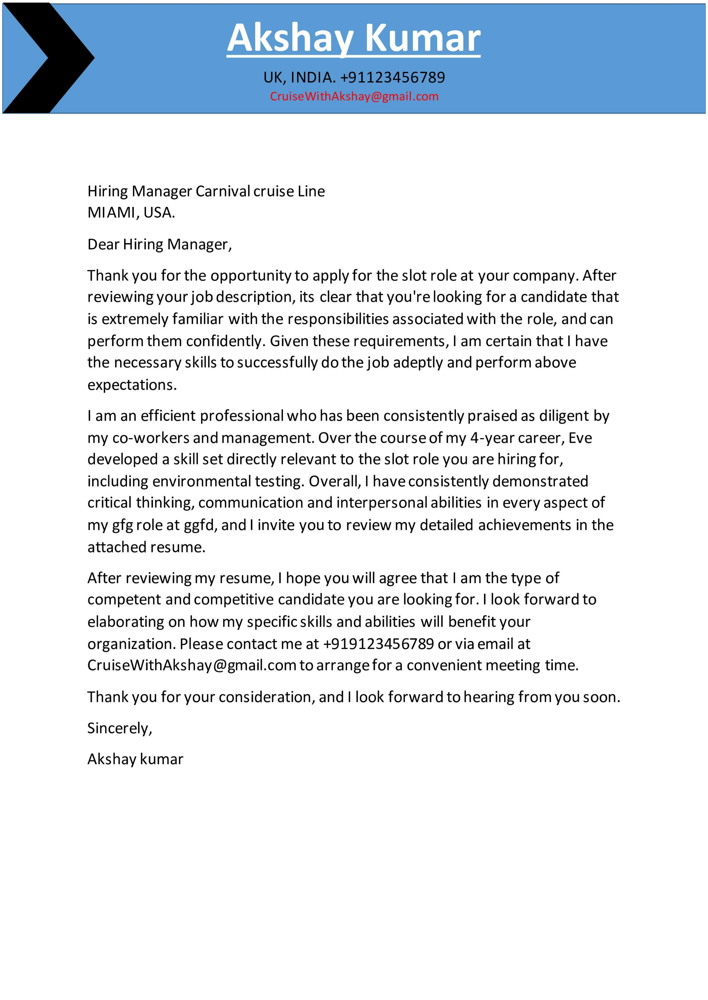

In [63]:
display(image_file)

In [64]:
#inverted images

In [65]:

inverted_image = cv2.bitwise_not(img)
cv2.imwrite("temp_inverted.jpg", inverted_image)

True

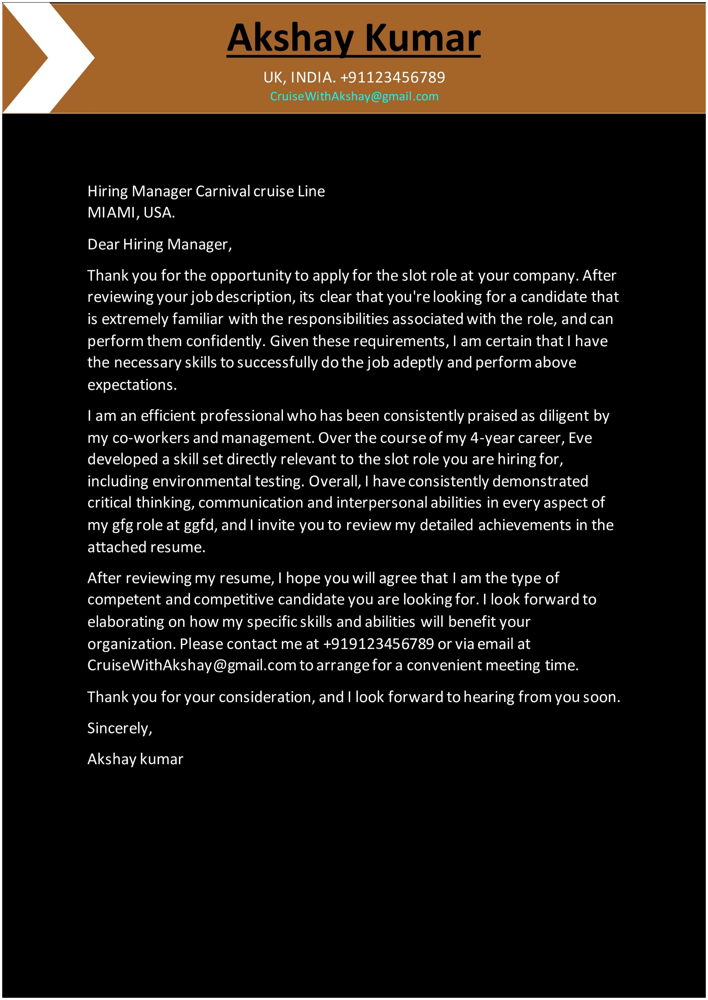

In [66]:
display("temp_inverted.jpg")

In [67]:
#Rescaling

In [68]:
#Rescaling

In [69]:
def grayscale(image):
  return cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
  cv2.imwrite("temp_gray_img.jpg",image)

In [70]:
gray_images = grayscale(img)
cv2.imwrite("temp_gray_images.jpg", gray_images)


True

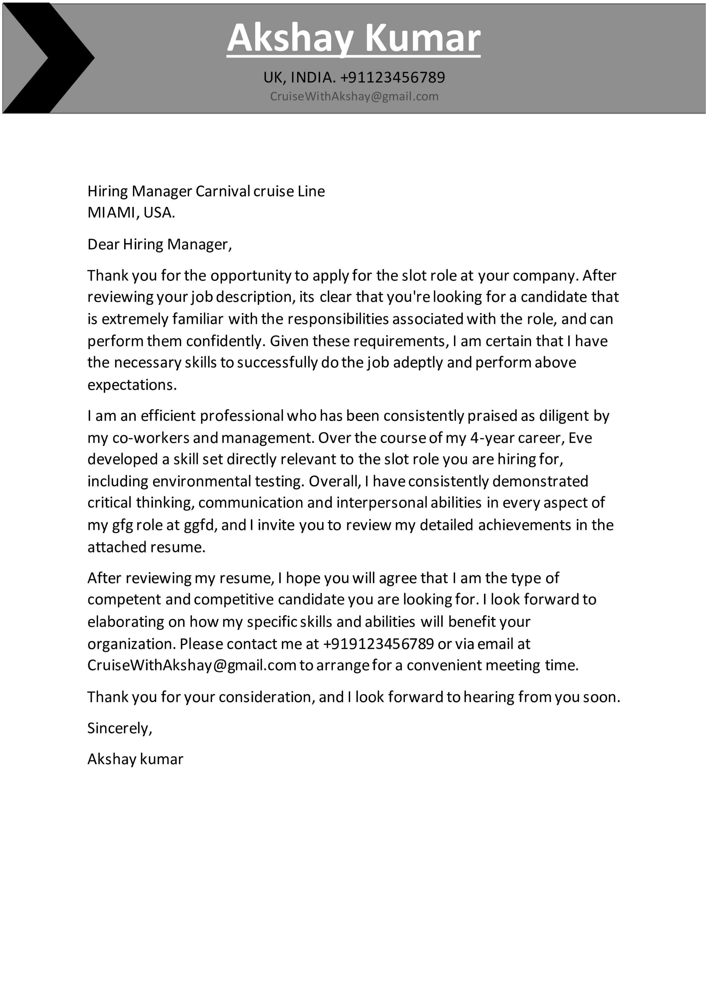

In [71]:
display("temp_gray_images.jpg")

In [72]:
thresh, im_bw = cv2.threshold(gray_images, 200, 255, cv2.THRESH_BINARY)
cv2.imwrite("temp_bw_images.jpg", im_bw)

True

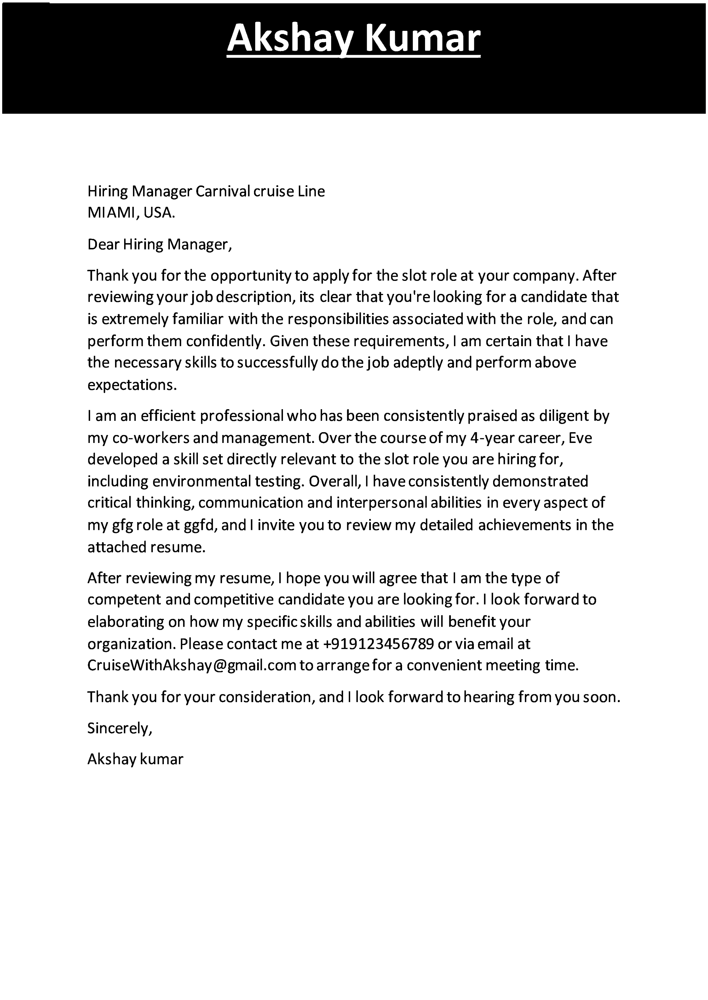

In [73]:
display("temp_bw_images.jpg")

In [74]:
#Noise removel

In [75]:
def noise_removel(image):
  import numpy as np
  kernel = np.ones((1, 1), np.uint8)
  image = cv2.dilate(image, kernel, iterations=1)
  kernel = np.ones((1,1), np.uint8)
  image = cv2.erode(image, kernel, iterations=1)
  image = cv2.morphologyEx(image, cv2.MORPH_CLOSE, kernel)
  image = cv2.medianBlur(image, 3)
  return(image)

In [76]:
no_noise = noise_removel(im_bw)
cv2.imwrite("temp_no_noise.jpg", no_noise)


True

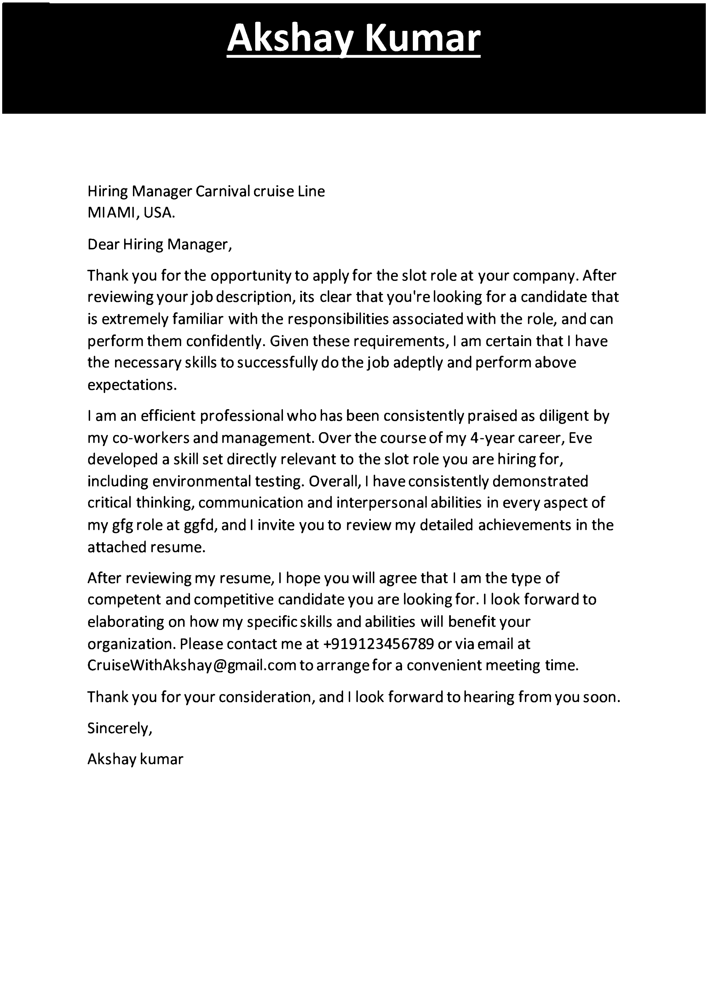

In [77]:
display("temp_no_noise.jpg")

In [78]:
#Dilations and Erosion

In [79]:
!pip install numpy

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [80]:
def thin_font(image):
  import numpy as np
  image = cv2.bitwise_not(image)
  kernel = np.ones((2,2),np.uint8)
  image = cv2.erode(image, kernel, iterations=1)
  image = cv2.bitwise_not(image)
  return(image)

In [81]:
eroded_image = thin_font(no_noise)
cv2.imwrite("temp_eroded_image.jpg", eroded_image)

True

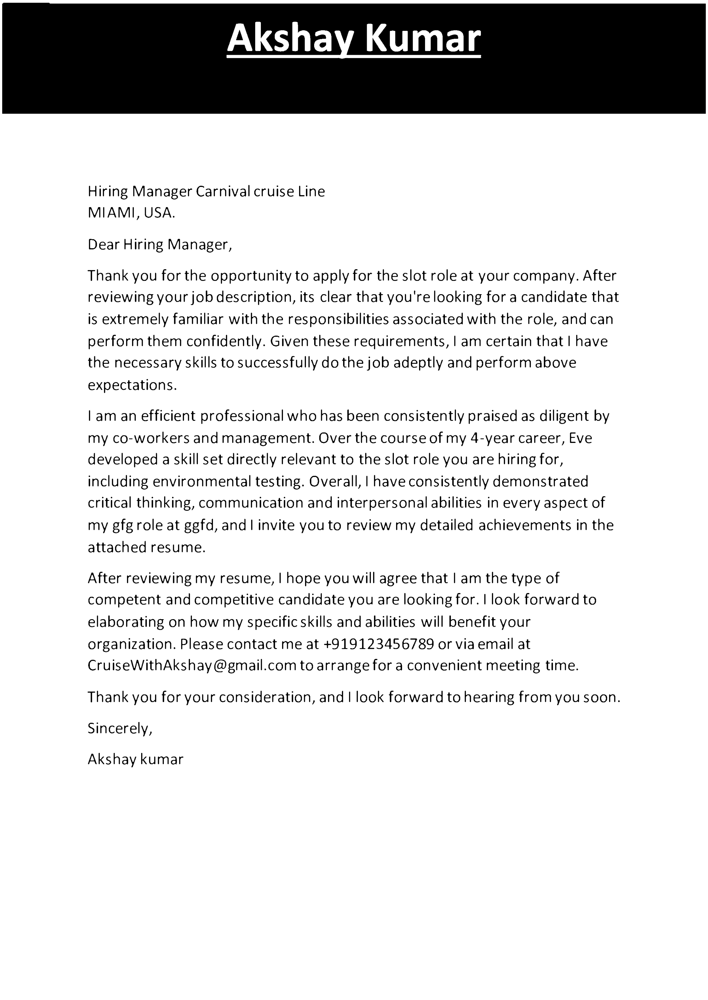

In [82]:
display("temp_eroded_image.jpg")

In [83]:
def thick_font(image):
  import numpy as np
  image = cv2.bitwise_not(image)
  kernel = np.ones((2,2),np.uint8)
  image = cv2.dilate(image, kernel, iterations=1)
  image = cv2.bitwise_not(image)
  return(image)

In [84]:
dilated_image = thick_font(no_noise)
cv2.imwrite("temp_dilate_image.jpg", dilated_image)

True

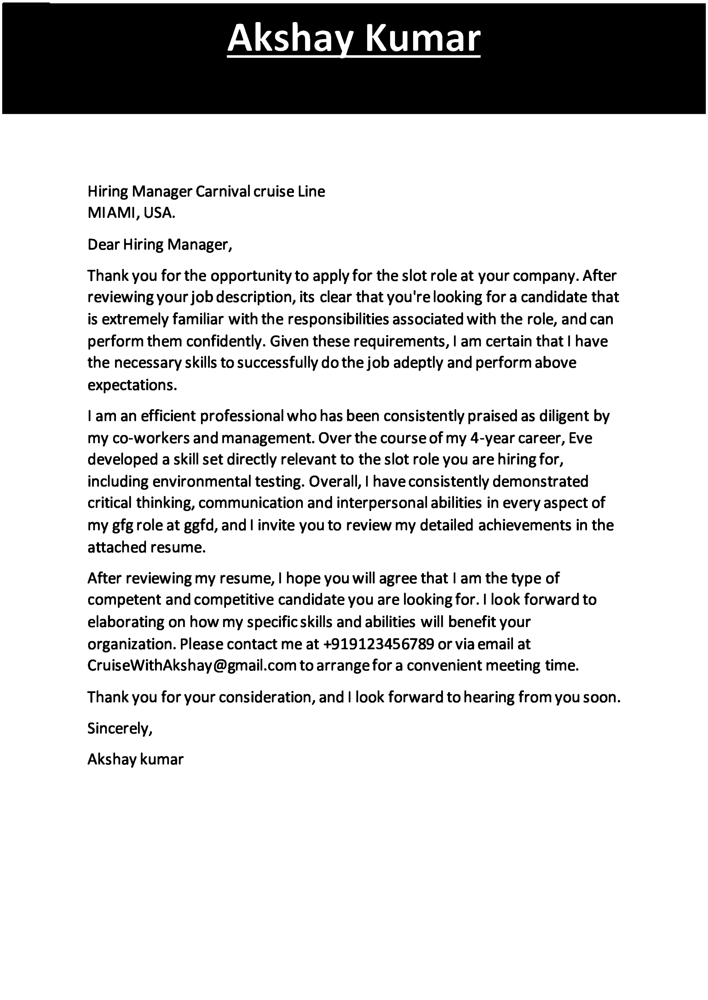

In [85]:
display("temp_dilate_image.jpg")

In [86]:
#Rotations and Deskewing

In [87]:
new = cv2.imread("/content/Standard Cover Letter (2).jpg")

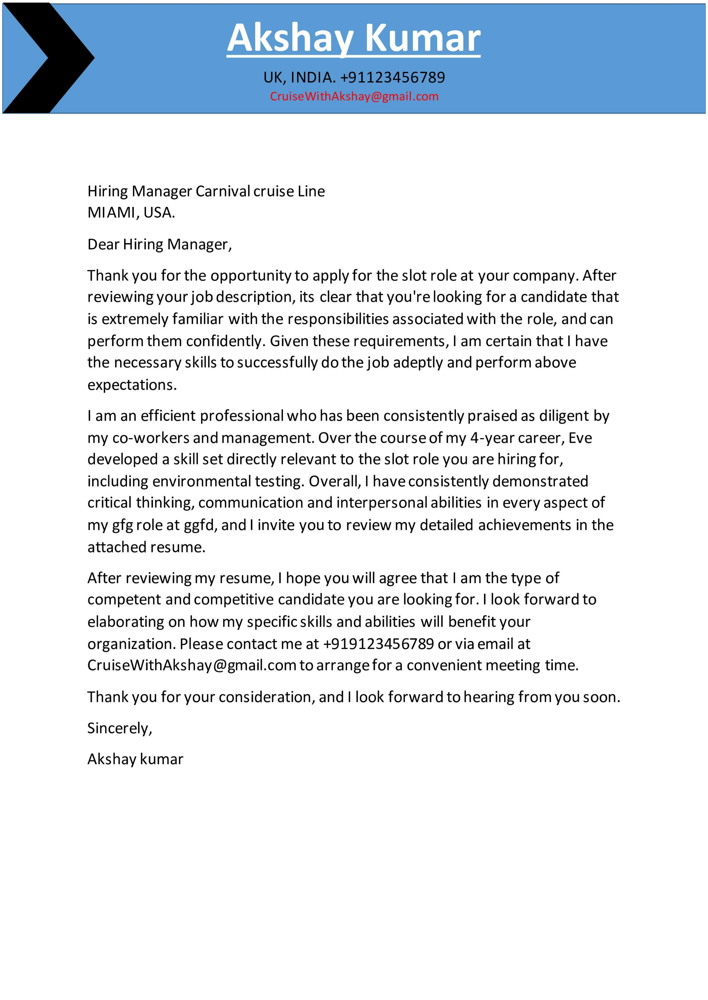

In [88]:
display("/content/Standard Cover Letter (2).jpg")

In [89]:
"""import numpy as np

def getSkewAngle(cvImage) -> float:
   #Prep image copy convert to gray scale, blur, and threshold
   newImage = cvImage.copy()
   gray = cv2.cvtColor(newImage, cv2.COLOR_BGR2GRAY)
   blur = cv2.GaussianBlur(gray, (9,9), 0)
   thresh = cv2.threshold(blur, 0, 255, cv2.THRESH_BINARY_INV+cv2.THRESH_OTSU)[1]

   #Apply dilate to merge text into meaningful lines/paragraph.
   #Use larger kernelon X axis to merge characters into single line cancelling out any space.
   #But use smaller kernel on Y axiss of test to seprate between different block text.

   kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (30,5))
   dilate = cv2.dilate(thresh, kernel, iterations=2)

   #find all contours 
   
   contours, hierachy = cv2.FindContours(dilate, cv2.RETR_LIST, cv2.CHAIN_APPROX_SIMPLE)
   contours =  sorted(contours, key = cv2.contoursArea, reverse = True)
   for c in contours:
     rect = cv2.boundingRect(c)
     x,y,w,h = rect
     cv2.rectangle(newImage,(x,y),(x+w,y+h),(0,255,0),2)

   #find Largest contours and surround in min area box
   largestContour  = contour[0]
   print(len(contours))
   minAreaRect = cv2.minAreaRect(largestaContour)
   cv2.imwrite("temp/boxes.jpg", newImage)
   #Determinethe angle , convert it to the value that was originally used to obtain skewed image
   angle = minAreaRect[-1]
   if angle < -45:
    angle = 90 + angle
   return -1.0 * angle

# Rotate the image around its center
# Rotate the image around its center
def rotateImage(cvImage, angle: float):
    newImage = cvImage.copy()
    (h, w) = newImage.shape[:2]
    center = (w // 2, h // 2)
    M = cv2.getRotationMatrix2D(center, angle, 1.0)
    newImage = cv2.warpAffine(newImage, M, (w, h), flags=cv2.INTER_CUBIC, borderMode=cv2.BORDER_REPLICATE)
    return newImage"""


'import numpy as np\n\ndef getSkewAngle(cvImage) -> float:\n   #Prep image copy convert to gray scale, blur, and threshold\n   newImage = cvImage.copy()\n   gray = cv2.cvtColor(newImage, cv2.COLOR_BGR2GRAY)\n   blur = cv2.GaussianBlur(gray, (9,9), 0)\n   thresh = cv2.threshold(blur, 0, 255, cv2.THRESH_BINARY_INV+cv2.THRESH_OTSU)[1]\n\n   #Apply dilate to merge text into meaningful lines/paragraph.\n   #Use larger kernelon X axis to merge characters into single line cancelling out any space.\n   #But use smaller kernel on Y axiss of test to seprate between different block text.\n\n   kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (30,5))\n   dilate = cv2.dilate(thresh, kernel, iterations=2)\n\n   #find all contours \n   \n   contours, hierachy = cv2.FindContours(dilate, cv2.RETR_LIST, cv2.CHAIN_APPROX_SIMPLE)\n   contours =  sorted(contours, key = cv2.contoursArea, reverse = True)\n   for c in contours:\n     rect = cv2.boundingRect(c)\n     x,y,w,h = rect\n     cv2.rectangle(newIma

In [90]:
#https://becominghuman.ai/how-to-automatically-deskew-straighten-a-text-image-using-opencv-a0c30aed83df
import numpy as np

def getSkewAngle(cvImage) -> float:
    # Prep image, copy, convert to gray scale, blur, and threshold
    newImage = cvImage.copy()
    gray = cv2.cvtColor(newImage, cv2.COLOR_BGR2GRAY)
    blur = cv2.GaussianBlur(gray, (9, 9), 0)
    thresh = cv2.threshold(blur, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)[1]

    # Apply dilate to merge text into meaningful lines/paragraphs.
    # Use larger kernel on X axis to merge characters into single line, cancelling out any spaces.
    # But use smaller kernel on Y axis to separate between different blocks of text
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (30, 5))
    dilate = cv2.dilate(thresh, kernel, iterations=2)

    # Find all contours
    contours, hierarchy = cv2.findContours(dilate, cv2.RETR_LIST, cv2.CHAIN_APPROX_SIMPLE)
    contours = sorted(contours, key = cv2.contourArea, reverse = True)
    for c in contours:
        rect = cv2.boundingRect(c)
        x,y,w,h = rect
        cv2.rectangle(newImage,(x,y),(x+w,y+h),(0,255,0),2)

    # Find largest contour and surround in min area box
    largestContour = contours[0]
    print (len(contours))
    minAreaRect = cv2.minAreaRect(largestContour)
    cv2.imwrite("temp/boxes.jpg", newImage)
    # Determine the angle. Convert it to the value that was originally used to obtain skewed image
    angle = minAreaRect[-1]
    if angle < -45:
        angle = 90 + angle
    return -1.0 * angle
# Rotate the image around its center
def rotateImage(cvImage, angle: float):
    newImage = cvImage.copy()
    (h, w) = newImage.shape[:2]
    center = (w // 2, h // 2)
    M = cv2.getRotationMatrix2D(center, angle, 1.0)
    newImage = cv2.warpAffine(newImage, M, (w, h), flags=cv2.INTER_CUBIC, borderMode=cv2.BORDER_REPLICATE)
    return newImage

In [91]:
# Deskew image
def deskew(cvImage):
    angle = getSkewAngle(cvImage)
    return rotateImage(cvImage, -1.0 * angle)

In [92]:
fixed = deskew(new)
cv2.imwrite("temp_rotated_fixed.jpg", fixed)

27


True

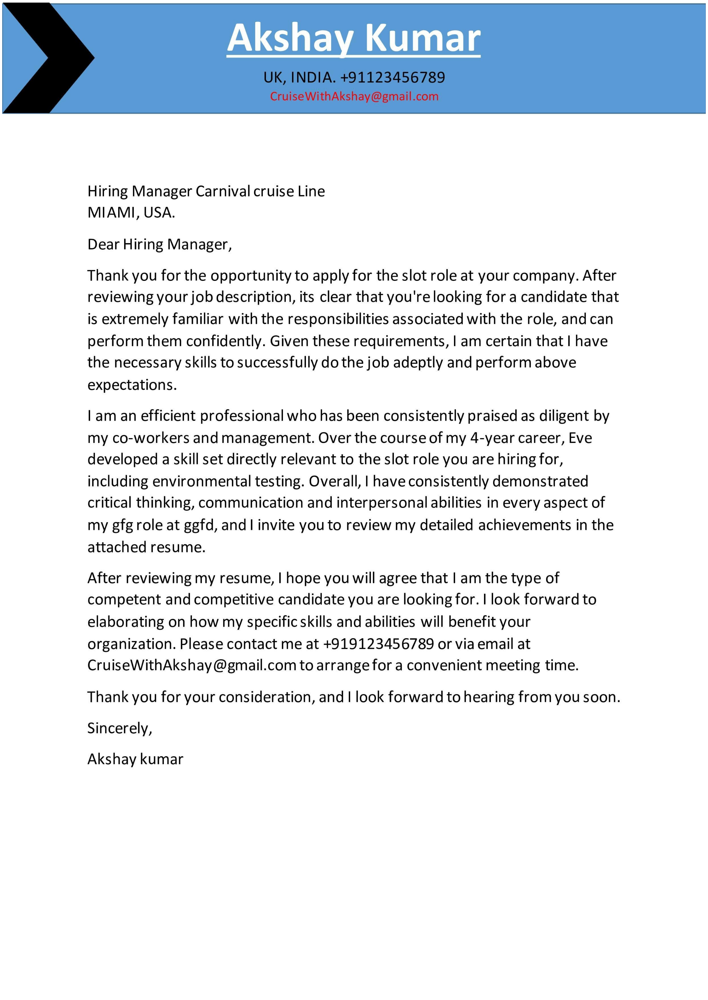

In [93]:
display("temp_rotated_fixed.jpg")

#Removing Borders

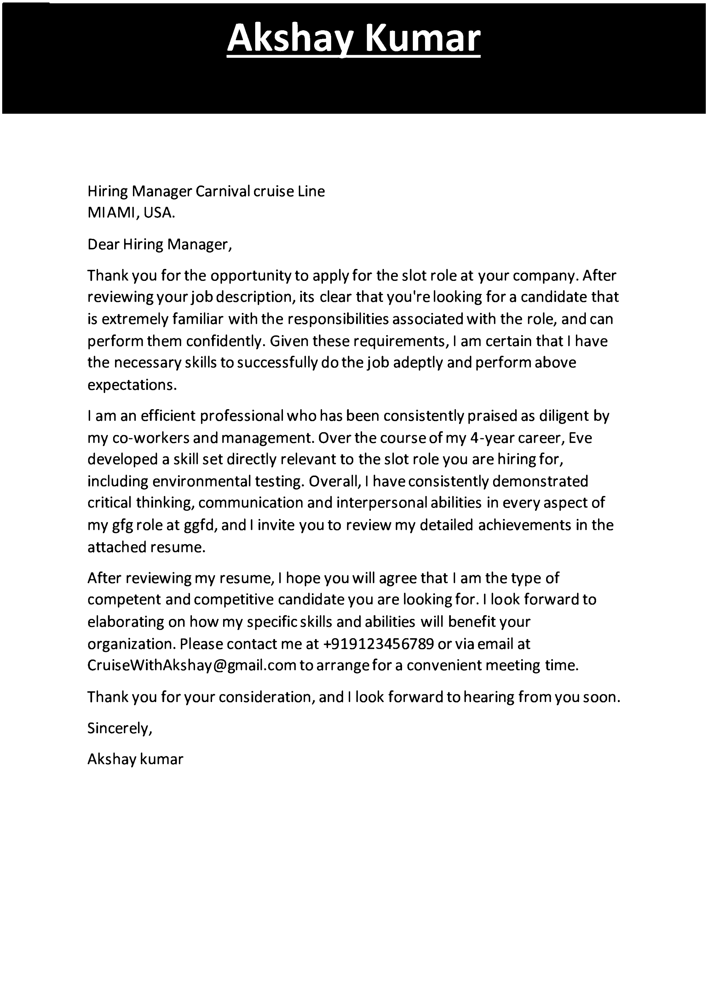

In [94]:
display("temp_no_noise.jpg")

In [95]:
def remove_borders(image):
    contours, heiarchy = cv2.findContours(image, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    cntsSorted = sorted(contours, key=lambda x:cv2.contourArea(x))
    cnt = cntsSorted[-1]
    x, y, w, h = cv2.boundingRect(cnt)
    crop = image[y:y+h, x:x+w]
    return (crop)

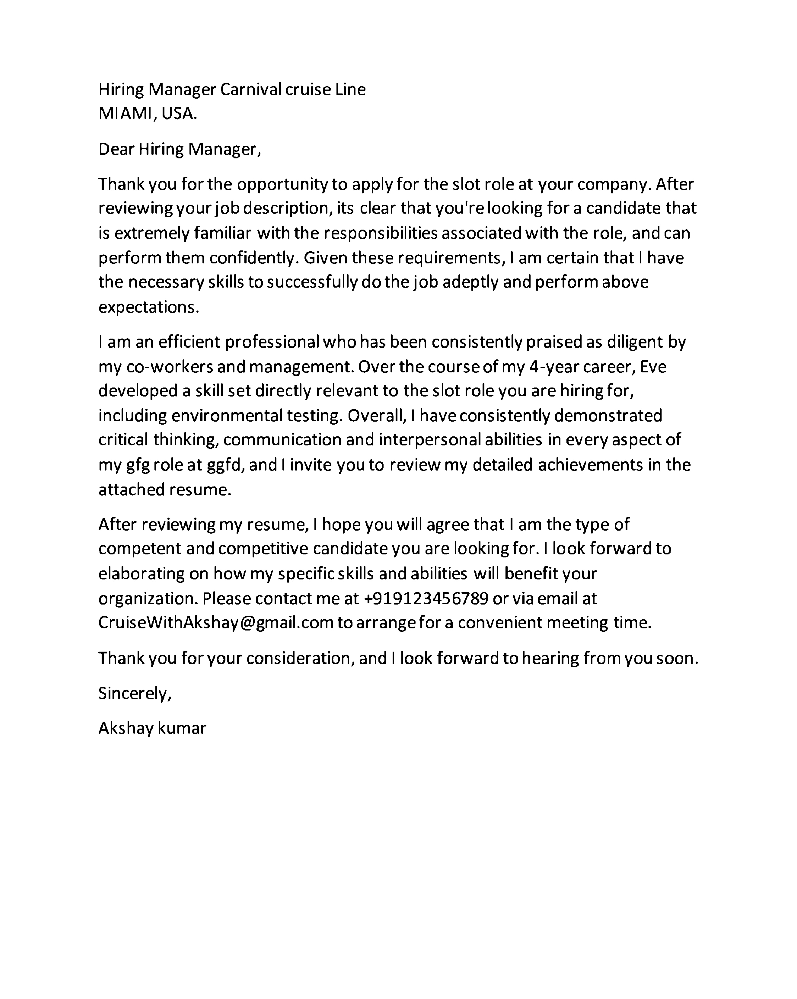

In [97]:
no_borders = remove_borders(no_noise)
cv2.imwrite("temp_no_borders.jpg", no_borders)
display('temp_no_borders.jpg')

#Missing Borders

In [98]:
color = [255, 255, 255]
top, bottom, left, right = [150]*4

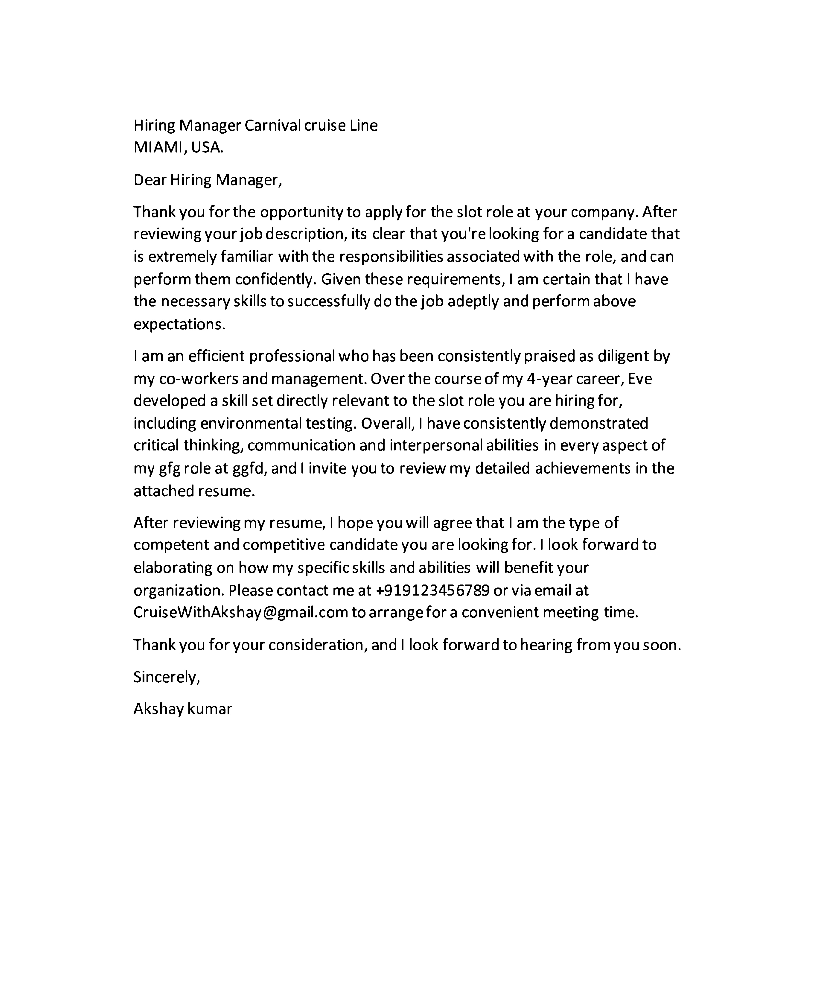

In [99]:
image_with_border = cv2.copyMakeBorder(no_borders, top, bottom, left, right, cv2.BORDER_CONSTANT, value=color)
cv2.imwrite("temp_image_with_border.jpg", image_with_border)
display("temp_image_with_border.jpg")